# Kmeans-based

## Import package

In [1]:
# basic
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks, peak_prominences

# openCV
import cv2

# sklearn


## Read dataset

In [2]:
root = './dataset/'
path = 'image/'

# read data, notice: each image have different size
images = []
for file in os.listdir(root + path):
    img = Image.open(root + path + file)
    img = np.array(img)
    images.append(img)

## K-means

### Statistics water segment

#### load labels

In [3]:
path = 'mask/'

# read mask, notice: each image have different size
masks = []
for file in os.listdir(root + path):
    mask = Image.open(root + path + file)
    mask = np.array(mask)
    masks.append(mask)

#### ROI Image

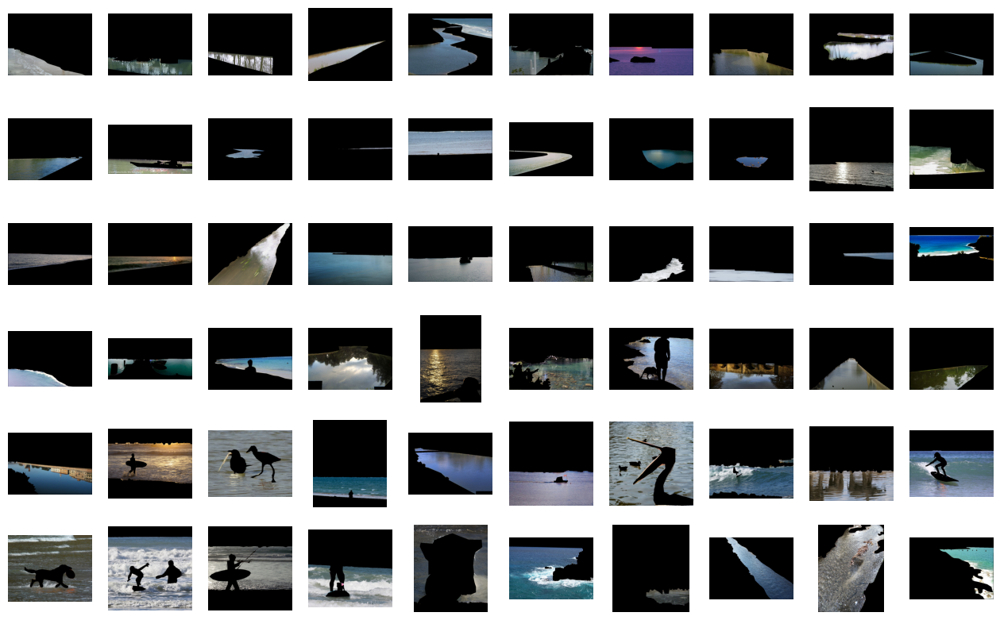

In [59]:
plt.figure(figsize=(16, 10))
pics = 60

roi_images = []
for idx in range(60):
    img, mask = images[idx], masks[idx]
    
    # roi image
    roi_image = np.zeros_like(img)
    for ch in range(3):
        roi_image[:, :, ch] = cv2.bitwise_and(img[:, :, ch], mask)
    roi_images.append(roi_image.astype(np.float64))

    # plot
    row = pics // 6
    col = pics // row
    
    plt.subplot(col, row, idx + 1), plt.axis('off')
    plt.imshow(roi_image)
    
plt.show()


#### Pixel analysis

In [79]:
# get non-zero pixel to analysis
count = 0
b_value, g_value, r_value = 0, 0, 0
b_acc, g_acc, r_acc = 0, 0, 0

for roi_img in roi_images[0:10]:
    # statcis info of each channel
    count += np.nonzero(np.sum(roi_img, axis=2))[0].shape[0]
    b_value += roi_img[:, :, 0].sum()
    g_value += roi_img[:, :, 1].sum()
    r_value += roi_img[:, :, 2].sum()
    
    b_acc += np.square(roi_img[:, :, 0]).sum()
    g_acc += np.square(roi_img[:, :, 1]).sum()
    r_acc += np.square(roi_img[:, :, 2]).sum()

b_mean, g_mean, r_mean = b_value/count, g_value/count, r_value/count
b_std, g_std, r_std= np.sqrt(b_acc/count-b_mean**2), np.sqrt(g_acc/count-g_mean**2), np.sqrt(r_acc/count-r_mean**2)

print('Water region distribution:')
print('Blue:  mean -', b_mean, 'std -', b_std)
print('Red:   mean -', r_mean, 'std -', r_std)
print('Green: mean -', g_mean, 'std -', g_std)

Water region distribution:
Blue:  mean - 99.69006530791857 std - 45.74399776588326
Red:   mean - 114.96137088834384 std - 47.02586249876725
Green: mean - 106.2109787467896 std - 43.658511948996505


#### Color mask

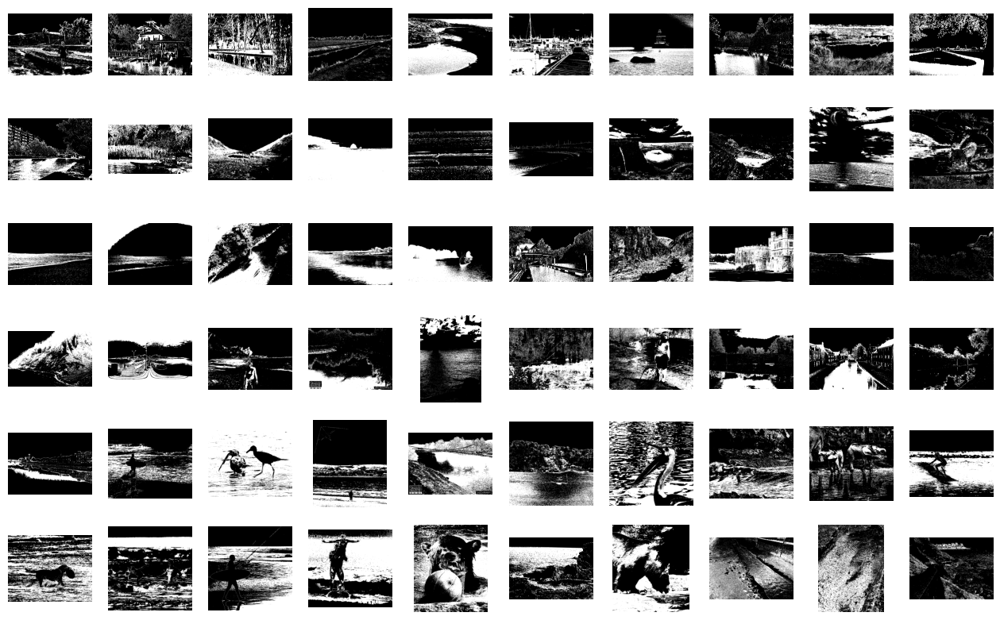

In [101]:
plt.figure(figsize=(16, 10))
pics = 60

color_masks = []
for idx in range(60):
    img = images[idx]
    
    # color mask
    lower_bound = [b_mean - b_std, g_mean - g_std, r_mean - r_std]
    upper_bound = [b_mean + b_std, g_mean + g_std, r_mean + r_std]
    color_mask = np.all((img >= lower_bound) & (img <= upper_bound), axis=-1)
    color_masks.append(color_mask.astype(np.uint8)*255)
    
    # plot
    row = pics // 6
    col = pics // row
    
    plt.subplot(col, row, idx + 1), plt.axis('off')
    plt.imshow(color_mask, cmap='gray')
    
plt.show()

### RGB histogram

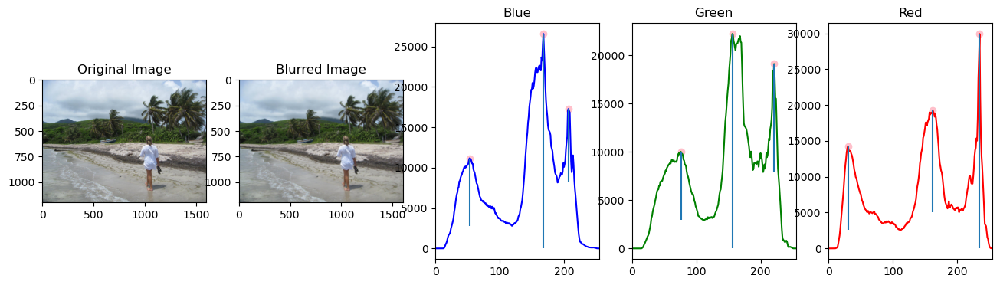

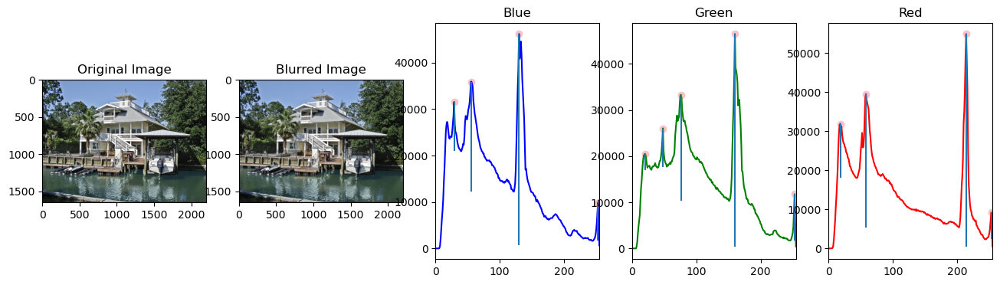

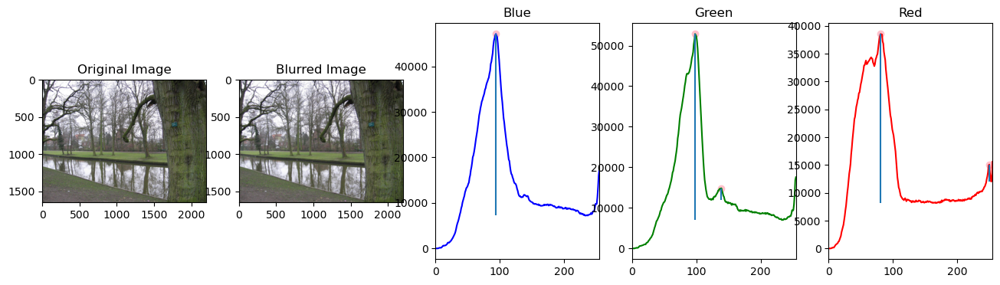

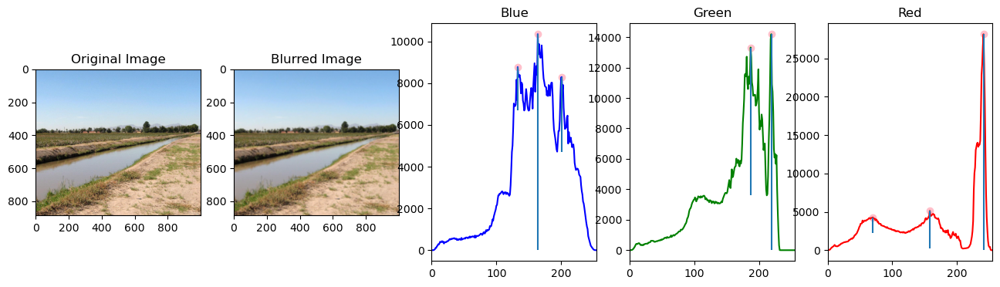

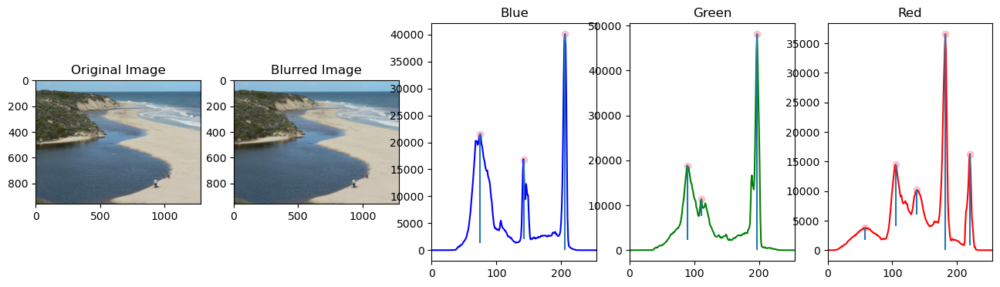

...

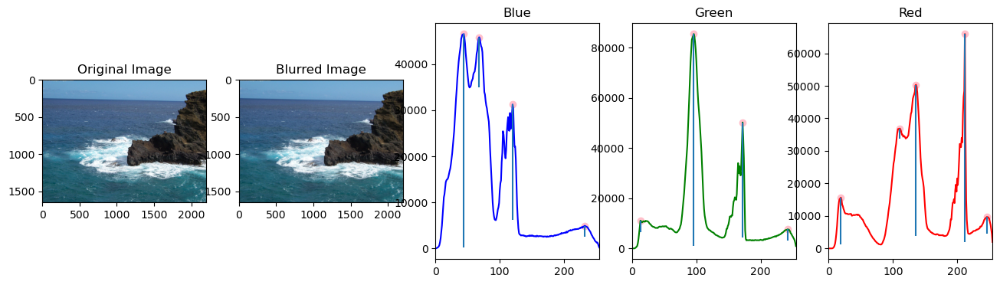

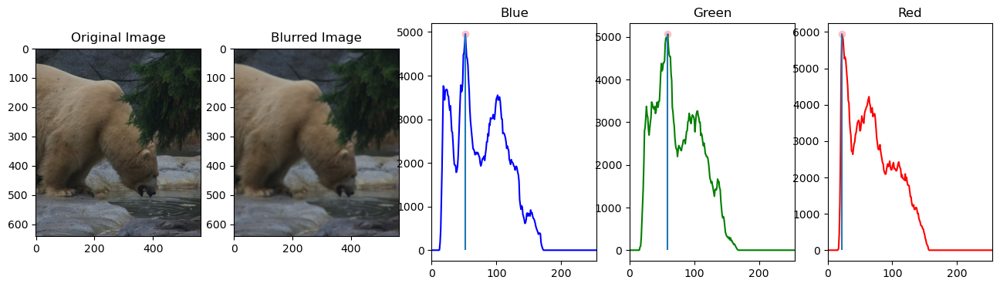

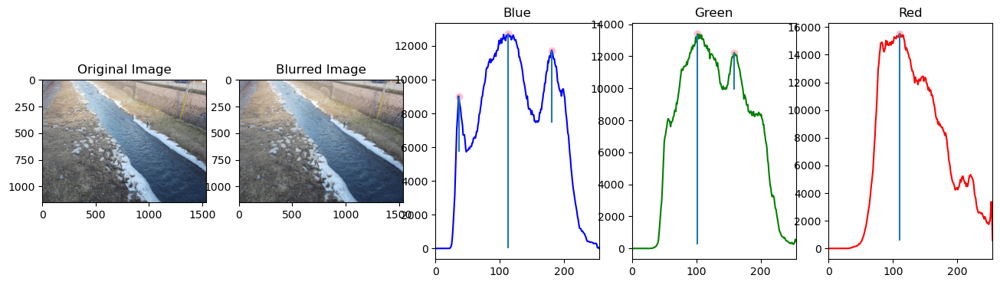

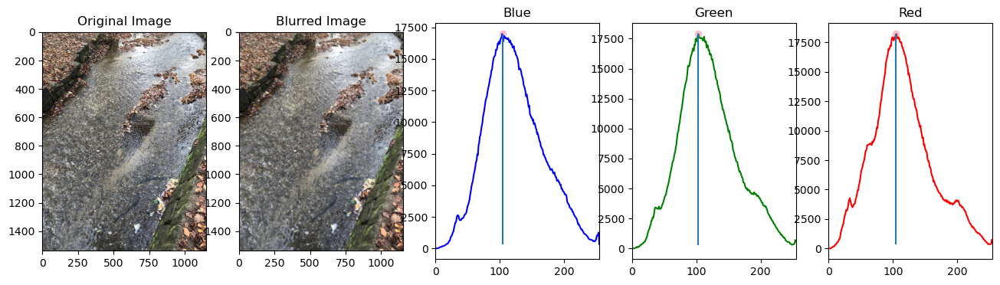

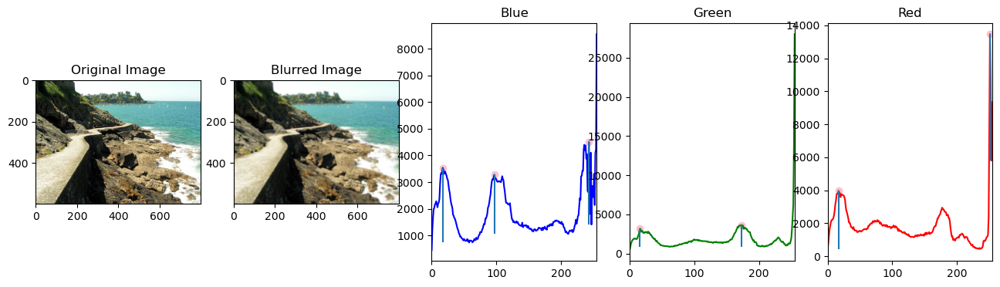

In [104]:
# look into histogram (gray-level or colorful) and decide how much cluster we need
channel = ['Blue', 'Green', 'Red']
color = ['b', 'g', 'r']

K = []
for idx, img in enumerate(images):
    plt.figure(figsize=(16, 4))
    plt.subplot(1, 5, 1)
    plt.imshow(img)
    plt.title("Original Image")
    
    k = 2
    for ch in range(3):
        blur_img = cv2.GaussianBlur(img, (7, 7), 3)
        
        plt.subplot(1, 5, 2)
        plt.imshow(blur_img)
        plt.title("Blurred Image")
        
        hist = cv2.calcHist([blur_img], [ch], None, [256], [0, 256])
        x = hist.flatten()
        
        peaks, properties = find_peaks(x, height=0, distance=20, prominence=2000)
        prominences = peak_prominences(x, peaks)[0]
        
        if ch == 0:
            k_max = len(peaks)
            k_min = len(peaks)
        
        k_max = max(k_max, len(peaks))
        k_min = min(k_min, len(peaks))

        plt.subplot(1, 5, ch + 3)
        plt.plot(hist, color=color[ch]), plt.xlim([0, 255])
        plt.scatter(peaks, x[peaks], c='pink', marker='o')
        plt.vlines(peaks, ymin=x[peaks] - prominences, ymax=x[peaks])
        plt.title(channel[ch])

    diff = k_max - k_min
    if diff >= 2:
        k = round((k_max + k_min)/2)
        K.append(k)
    elif k_max == 1:
        K.append(2)
    else:
        K.append(k_max)

    plt.show()

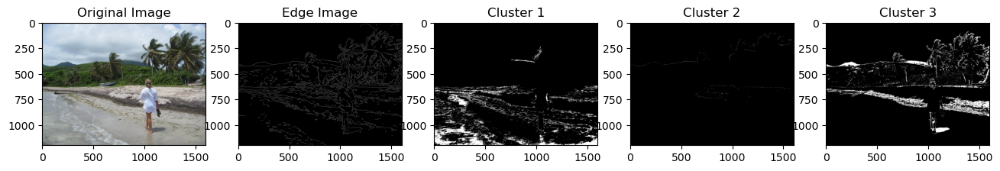

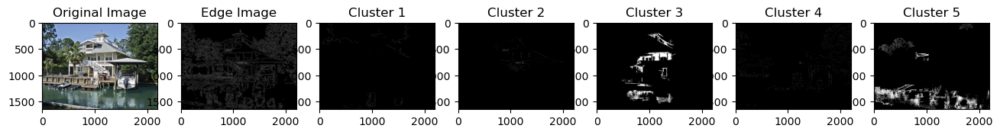

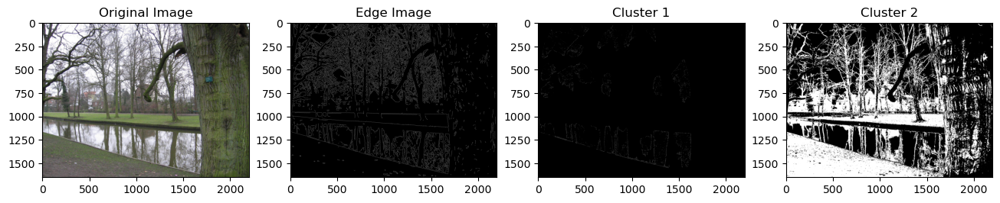

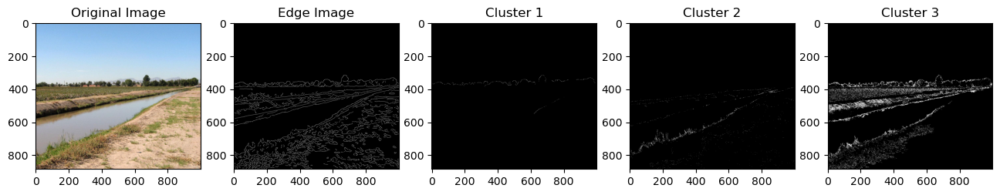

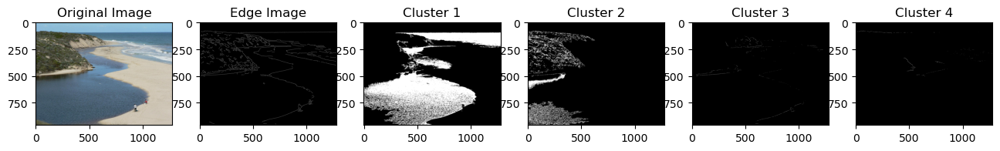

...

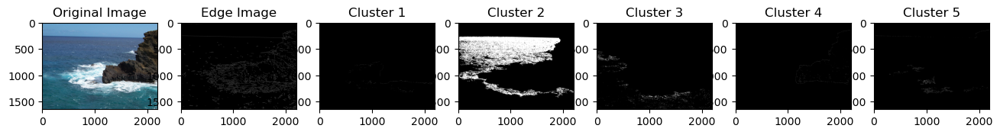

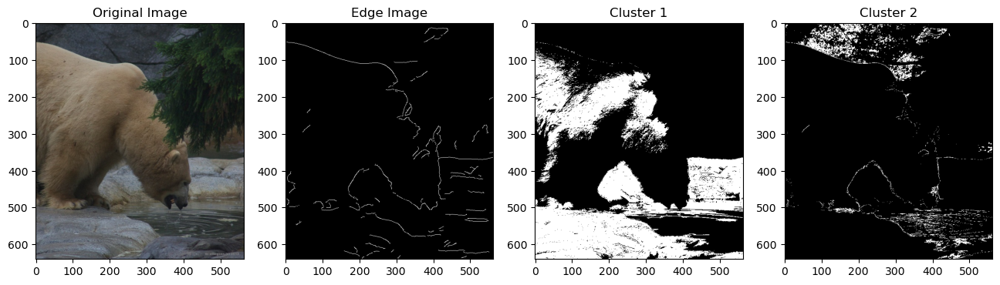

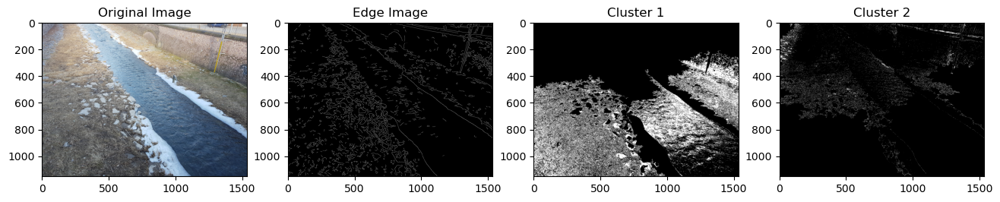

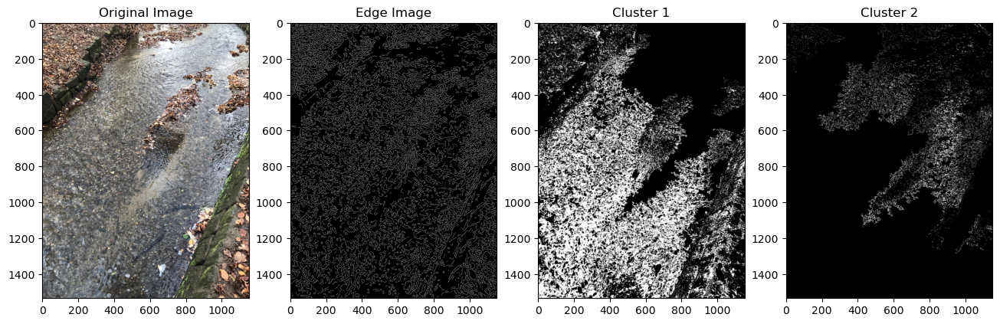

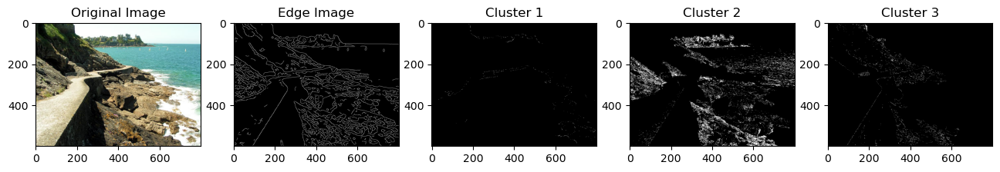

In [107]:
for idx, img in enumerate(images):

    blur_img = cv2.GaussianBlur(img, (25, 25), 3)
    edge_img = cv2.Canny(blur_img, 20, 50)
    
    pixel_vals = img.reshape((-1, 3))
    pixel_vals = np.float32(pixel_vals)
    
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.85)
 
    # then perform k-means clustering with number of clusters defined as 3
    # also random centres are initially choosed for k-means clustering
    k = K[idx]
    retval, labels, centers = cv2.kmeans(pixel_vals, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    
    # convert data into 8-bit values
    centers = np.uint8(centers)
    segmented_data = centers[labels.flatten()]
    
    # reshape data into the original image dimensions
    segmented_image = segmented_data.reshape((img.shape))
    
    binary_images = [np.where(labels == i, 255, 0).reshape(img.shape[:2]) for i in range(k)]
    
    pics = k + 2
    plt.figure(figsize=(16, 10))
    plt.subplot(1, pics, 1)
    plt.imshow(img)
    plt.title("Original Image")
    
    plt.subplot(1, pics, 2)
    plt.imshow(edge_img, cmap='gray')
    plt.title("Edge Image")
    
    for i, binary_image in enumerate(binary_images):
        
        binary_image = binary_image.astype(np.uint8)
        binary_image = binary_image - edge_img
        
        # connected component analysis
        num_objects, labels, stats, centroids = cv2.connectedComponentsWithStats(binary_image)
        output = np.zeros(binary_image.shape, dtype="uint8")
        for j in range(1, num_objects):
            area = stats[j, cv2.CC_STAT_AREA]
            if area > 10000:
                mask = (labels == j).astype('uint8') * 255
                output = cv2.bitwise_or(output, mask)
        
        # color mask
        output = cv2.bitwise_and(output, color_masks[idx])
        
        # monography: open + close
        # kernel = np.ones((7 , 7), np.uint8)
        # mask_adaptive = cv2.morphologyEx(output, cv2.MORPH_OPEN, kernel)
        # mask_adaptive = cv2.morphologyEx(mask_adaptive, cv2.MORPH_CLOSE, kernel)
        
        # plot
        plt.subplot(1, pics, i + 3)
        plt.imshow(output, cmap='gray')
        plt.title(f"Cluster {i + 1}")
        
    plt.show()